In [1]:
import scanpy as sc
import pandas as pd
from anndata import AnnData, concat
import matplotlib.pyplot as plt
import os
data_type = 'float32'
os.environ["THEANO_FLAGS"] = 'device=cuda,floatX=' + data_type + ',force_device=True'
import cell2location
from cell2location.models import RegressionModel
from cell2location.utils.filtering import filter_genes
import numpy as np
from cell2location import run_colocation
%matplotlib inline

# reference building

In [ ]:
def train_reference(region_ref,
                    annotation_colname,
                    batch_key,
                    continuous_covariate_keys,
                    categorical_covariate_keys,
                    write_prefix,
                    cell_number_thres=15):
    region_high_number_celltypes = list(region_ref.obs[annotation_colname].value_counts()[region_ref.obs[annotation_colname].value_counts() > cell_number_thres].index)
    print('Selected the following celltypes for getting signatures', region_high_number_celltypes)
    selected_region_ref = region_ref[region_ref.obs[annotation_colname].isin(region_high_number_celltypes)]
    # Regression model
    RegressionModel.setup_anndata(adata=selected_region_ref,
                                   batch_key=batch_key,
                                   labels_key=annotation_colname,
                                   continuous_covariate_keys=continuous_covariate_keys,
                                   categorical_covariate_keys=categorical_covariate_keys)
    mod = RegressionModel(selected_region_ref)
    print('Construct regression model:')
    print(mod.view_anndata_setup())
    print("Start training...")
    mod.train(max_epochs=250)
    selected_region_ref = mod.export_posterior(
        selected_region_ref, sample_kwargs={'num_samples': 1000, 'batch_size': 2500}
    )
    mod.save(f"{write_prefix}/regression_model", overwrite=True)
    print("Model saved in.", f'{write_prefix}/regression_model')
    selected_region_ref.write(f"{write_prefix}/ref.posterior.h5ad")
    print("Reference data with posterior values saved in ",
          f"{write_prefix}/ref.posterior.h5ad")
    return selected_region_ref, mod

In [2]:
adat = sc.read_h5ad("all_cells_final_amc_july2024.h5ad")
adat.obs['organ_uni'].value_counts()

organ_uni
lymph_node         89924
spleen             88136
oesophagus         85119
lung               74642
uterus             48862
muscle             48019
thymus             28823
large_intestine    26873
blood              25738
decidua            19970
heart              19636
bladder            18887
adipose_tissue     17358
small_intestine    15011
liver              14086
kidney             12549
brain              12541
large_vessels      11646
trachea            10838
pancreas            4382
Name: count, dtype: int64

In [9]:
selected_celltypes = [
    x for x in 
    list(adat.obs[adat.obs['organ_uni'] == 'uterus']['ann_final'].value_counts()[adat.obs[adat.obs['organ_uni'] == 'uterus']['ann_final'].value_counts()>15].index)
    if x != 'brain_art_smc'
]
selected_celltypes

['Fibroblasts',
 'Epithelial cells',
 'Lymphoid cells',
 'Myeloid cells',
 'art_smc',
 'endometrium_cap_ec',
 'cap_pc',
 'uterine_pc',
 'cap_ec',
 'uterine_smc',
 'art_ec_2',
 'B cells',
 'art_ec_1',
 'smc_pc_intermediate',
 'ven_ec_1',
 'cap_lec']

In [11]:
select = lambda x: True if x in selected_celltypes else False
adat.obs['isRef'] = [select(x) for x in adat.obs['ann_final'].values]

In [12]:
uterus_ref = adat[adat.obs['isRef'] == True].copy()
uterus_ref.obs['ann_final'].value_counts()

ann_final
Lymphoid cells         142125
Epithelial cells       140268
Fibroblasts            119628
Myeloid cells          113243
B cells                 78721
art_smc                 10130
cap_pc                   4093
cap_ec                   3334
art_ec_2                 2215
ven_ec_1                 2137
cap_lec                  2073
uterine_pc               1851
endometrium_cap_ec       1755
smc_pc_intermediate       946
art_ec_1                  858
uterine_smc               252
Name: count, dtype: int64

In [14]:
uterus_raw_sc = AnnData(
    X = uterus_ref.layers['counts'],
    obs = uterus_ref.obs[['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 
                          'study','kit', 'organ_uni', 'donor', 'ann_final']],
    var = uterus_ref.var
)
uterus_raw_sc

AnnData object with n_obs × n_vars = 623629 × 30021
    obs: 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'study', 'kit', 'organ_uni', 'donor', 'ann_final'

In [ ]:
selected_genes = filter_genes(uterus_raw_sc, cell_count_cutoff=5, cell_percentage_cutoff2=0.03, nonz_mean_cutoff=1.12)
uterus_raw_sc = uterus_raw_sc[:,uterus_raw_sc.var.index.isin(selected_genes)]
print(uterus_raw_sc.shape)
ref, mod = train_reference(region_ref=uterus_raw_sc,
                           annotation_colname="ann_final",
                           batch_key='study',
                           continuous_covariate_keys=['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                           categorical_covariate_keys=['kit', 'organ_uni'],
                           write_prefix="uterus_ref/",
                           cell_number_thres=15)

Selected the following celltypes for getting signatures ['Lymphoid cells', 'Epithelial cells', 'Fibroblasts', 'Myeloid cells', 'B cells', 'art_smc', 'cap_pc', 'cap_ec', 'art_ec_2', 'ven_ec_1', 'cap_lec', 'uterine_pc', 'endometrium_cap_ec', 'smc_pc_intermediate', 'art_ec_1', 'uterine_smc']


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/cell2location/models/reference/_reference_model.py:112: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["_indices"] = np.arange(adata.n_obs).astype("int64")


# c2l map

In [ ]:
uterus_vis_sc = sc.read("/lustre/scratch126/cellgen/team205/sl37/vasculature/data/public_visium/uterus/uterus_visium.lognormalized.h5ad")
uterus_ref_sc = sc.read("uterus_ref/ref.posterior.h5ad")

if 'means_per_cluster_mu_fg' in uterus_ref_sc.varm.keys():
    inf_aver = uterus_ref_sc.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}'
                                                          for i in uterus_ref_sc.uns['mod']['factor_names']]].copy()
else:
    inf_aver = uterus_ref_sc.var[[f'means_per_cluster_mu_fg_{i}'
                                      for i in uterus_ref_sc.uns['mod']['factor_names']]].copy()
inf_aver.columns = uterus_ref_sc.uns['mod']['factor_names']
intersect = np.intersect1d(uterus_vis_sc.var_names, inf_aver.index)
uterus_vis_sc = uterus_vis_sc[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()


# create and train the model
print("cell2location data setup")
cell2location.models.Cell2location.setup_anndata(adata=uterus_vis_sc,
                                                 layer='counts',
                                                 batch_key='sample')
print("cell2location model setup")
c2l_mod = cell2location.models.Cell2location(
    uterus_vis_sc,
    cell_state_df=inf_aver,
    N_cells_per_location=8,
    detection_alpha=20
)
print(c2l_mod.view_anndata_setup())
print("####### Start with Cell2location training model.")
c2l_mod.train(max_epochs=400,
          batch_size=1000,
          train_size=1)

uterus_vis_sc = c2l_mod.export_posterior(
        uterus_vis_sc, sample_kwargs={'num_samples': 1000,
                                  'batch_size': c2l_mod.adata.n_obs}
    )
os.makedirs("uterus_ref/ncells8_alpha200/")
c2l_mod.save("uterus_ref/ncells8_alpha200/", overwrite=True)
uterus_vis_sc.obs[uterus_vis_sc.uns['mod']['factor_names']] = uterus_vis_sc.obsm['q05_cell_abundance_w_sf']
print("computing KNN from estimated cell abundance")
sc.pp.neighbors(uterus_vis_sc, use_rep='q05_cell_abundance_w_sf', n_neighbors=15)
sc.tl.leiden(uterus_vis_sc)
uterus_vis_sc.obs["region_cluster"] = uterus_vis_sc.obs["leiden"].astype("category")
sc.tl.umap(uterus_vis_sc, min_dist=0.3, spread=1)
uterus_vis_sc.write("uterus_ref/ncells8_alpha200/sp.h5ad")

cell2location data setup
cell2location model setup


Anndata setup with scvi-tools version 1.1.5.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   4   │
│         n_cells          │ 14626 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 13984 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    ind_x     │   adata.obs['_indices']   │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │   152806   │          0          │
│                     │   152807   │          1          │
│                     │   152810   │          2          │
│                     │   152811   │          3          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


None
####### Start with Cell2location training model.


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/lightning/pytorch/trainer/configuration_validator.py:72: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|█| 400/400 [18:23<00:00,  3.96s/it, v_num=1, elbo_train=9.1

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [18:23<00:00,  2.76s/it, v_num=1, elbo_train=9.1
Sampling global variables, sample: 100%|█████| 999/999 [00:57<00:00, 17.23it/s]
computing KNN from estimated cell abundance


In [5]:
uterus_vis_sc

AnnData object with n_obs × n_vars = 14626 × 13984
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', '_indices', '_scvi_batch', '_scvi_labels', 'B cells', 'Epithelial cells', 'Fibroblasts', 'Lymphoid cells', 'Myeloid cells', 'art_ec_1', 'art_ec_2', 'art_smc', 'cap_ec', 'cap_lec', 'cap_pc', 'endometrium_cap_ec', 'smc_pc_intermediate', 'uterine_pc', 'uterine_smc', 'ven_ec_1', 'leiden', 'region_cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'mt'
    uns: 'log1p', 'spatial', '_scvi_uuid', '_scvi_manager_uuid', 'mod', 'neighbors', 'leiden', 'umap'
    obsm: 'spatial', 'means_cell_abundance_w_sf', 'stds_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q95_cell_abundance_w_sf', 'X_umap'
    layers:

In [6]:
uterus_vis_sc.obs['sample'].value_counts()

sample
152810    4006
152811    3871
152807    3403
152806    3346
Name: count, dtype: int64

In [9]:
uterus_vis_sc.uns['mod']['factor_names']

['B cells',
 'Epithelial cells',
 'Fibroblasts',
 'Lymphoid cells',
 'Myeloid cells',
 'art_ec_1',
 'art_ec_2',
 'art_smc',
 'cap_ec',
 'cap_lec',
 'cap_pc',
 'endometrium_cap_ec',
 'smc_pc_intermediate',
 'uterine_pc',
 'uterine_smc',
 'ven_ec_1']

# check res

In [2]:
uterus_vis = sc.read_h5ad("uterus_ref/ncells8_alpha200/sp.h5ad")
uterus_vis

AnnData object with n_obs × n_vars = 14626 × 13984
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', '_indices', '_scvi_batch', '_scvi_labels', 'B cells', 'Epithelial cells', 'Fibroblasts', 'Lymphoid cells', 'Myeloid cells', 'art_ec_1', 'art_ec_2', 'art_smc', 'cap_ec', 'cap_lec', 'cap_pc', 'endometrium_cap_ec', 'smc_pc_intermediate', 'uterine_pc', 'uterine_smc', 'ven_ec_1', 'leiden', 'region_cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'mt'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'log1p', 'mod', 'neighbors', 'spatial', 'umap'
    obsm: 'X_umap', 'means_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q95_cell_abundance_w_sf', 'spatial', 'stds_cell_abundance_w_sf'
    layers:

In [4]:
uterus_vis.uns['mod']['factor_names']

array(['B cells', 'Epithelial cells', 'Fibroblasts', 'Lymphoid cells',
       'Myeloid cells', 'art_ec_1', 'art_ec_2', 'art_smc', 'cap_ec',
       'cap_lec', 'cap_pc', 'endometrium_cap_ec', 'smc_pc_intermediate',
       'uterine_pc', 'uterine_smc', 'ven_ec_1'], dtype=object)

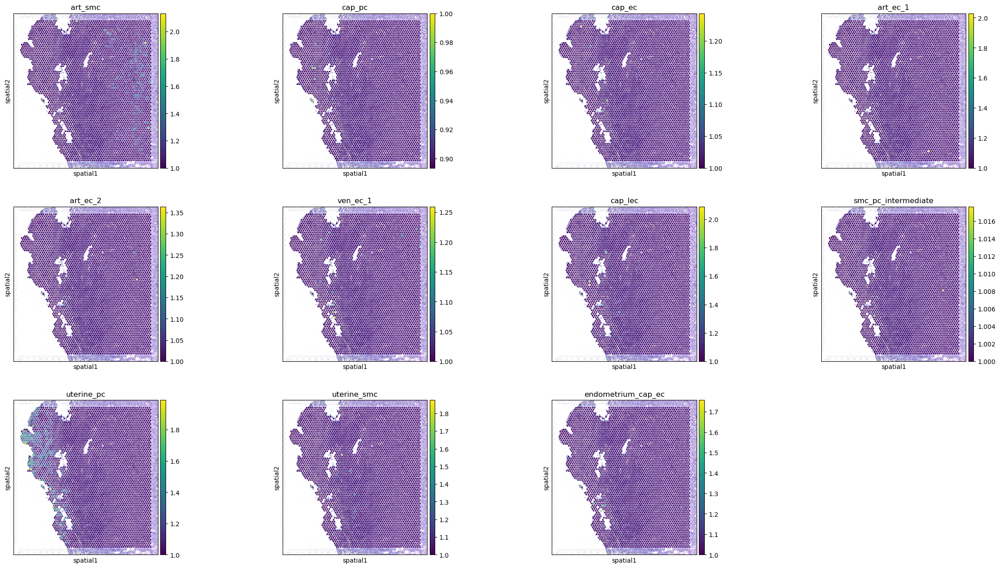

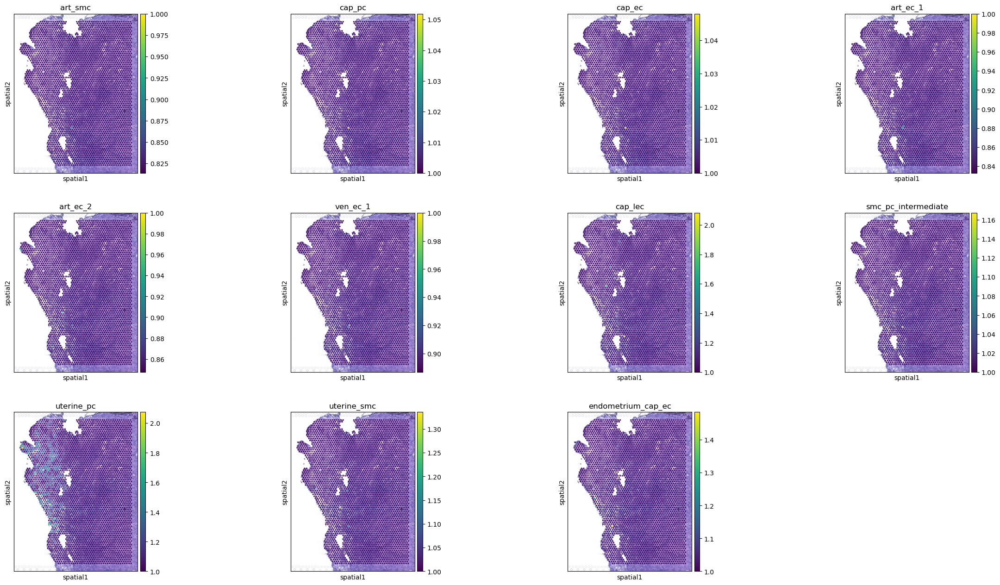

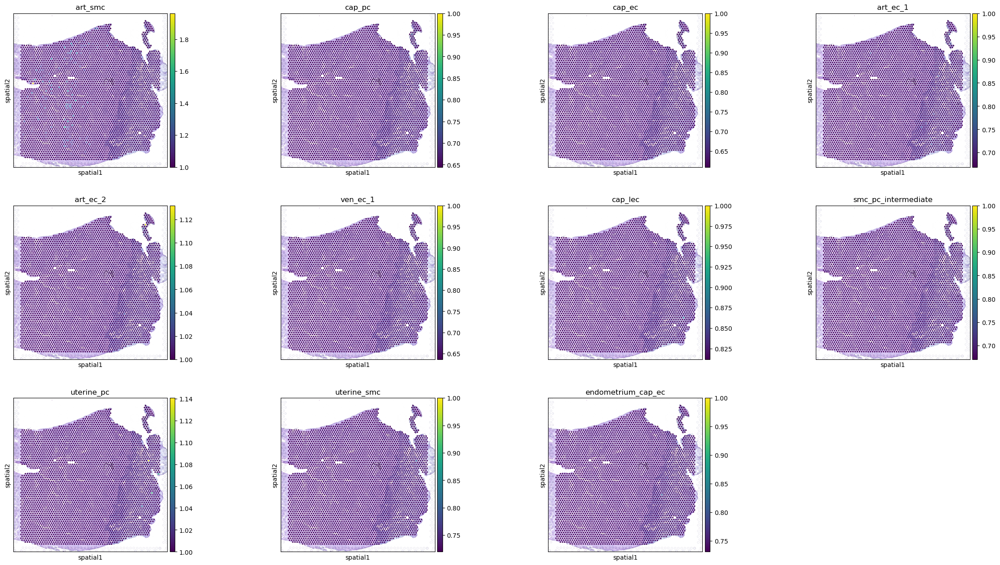

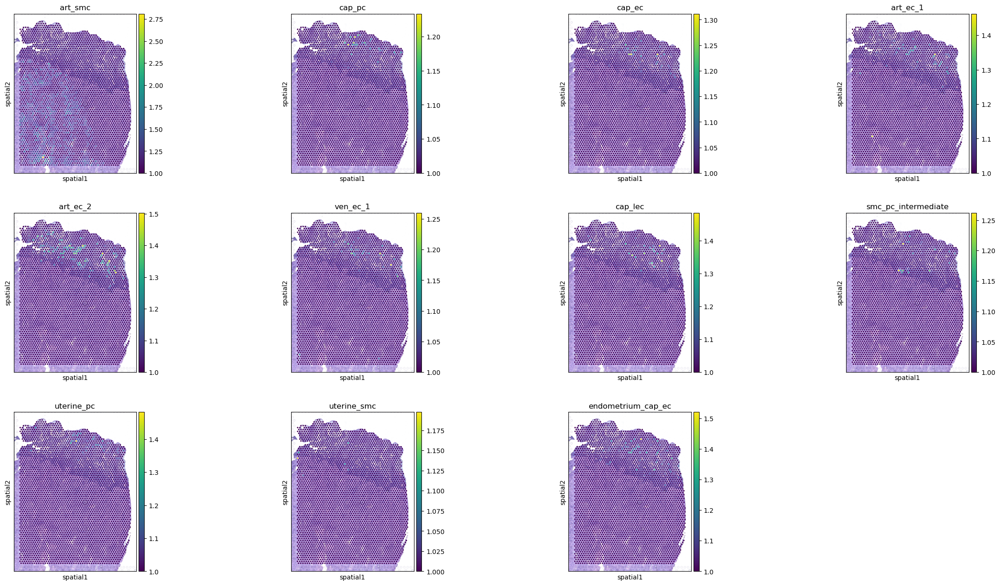

In [6]:
celltypes = ['art_smc', 'cap_pc', 'cap_ec', 'art_ec_1', 'art_ec_2', 'ven_ec_1', 'cap_lec', 'smc_pc_intermediate', 'uterine_pc', 'uterine_smc', 'endometrium_cap_ec']
# celltypes = ['uterine_pc', 'uterine_smc', 'endometrium_cap_ec']

for samplename in uterus_vis.obs['sample'].unique():
    sc.pl.spatial(uterus_vis[uterus_vis.obs['sample'] == samplename],
                  library_id = samplename,
                  color=celltypes,
                  vmin=1)

In [10]:
uterus_vis.obs['sample'].unique()

['152810', '152806', '152811', '152807']
Categories (4, object): ['152806', '152807', '152810', '152811']

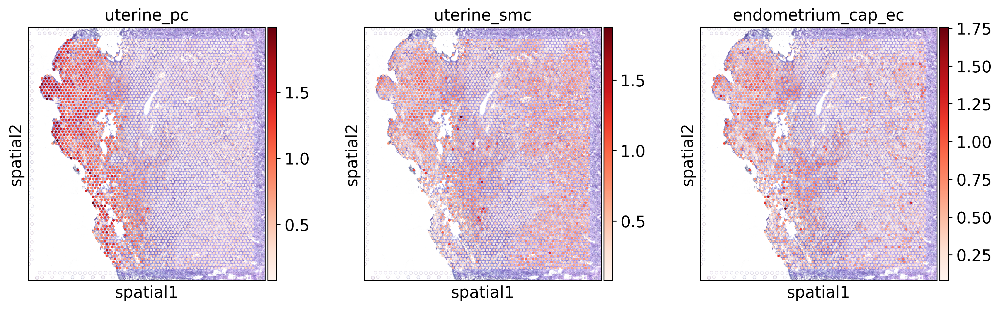

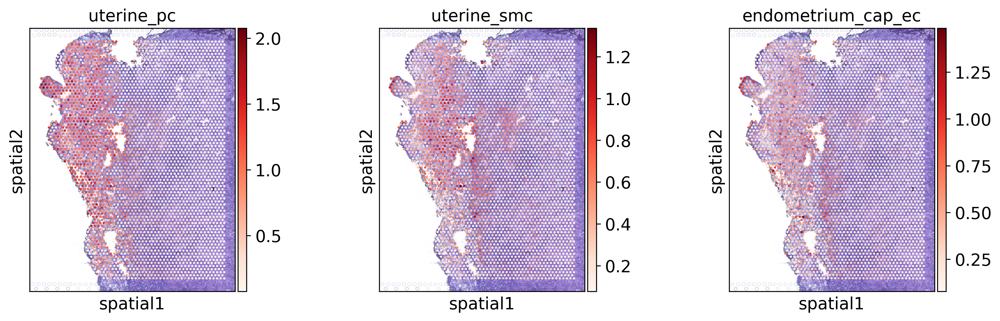

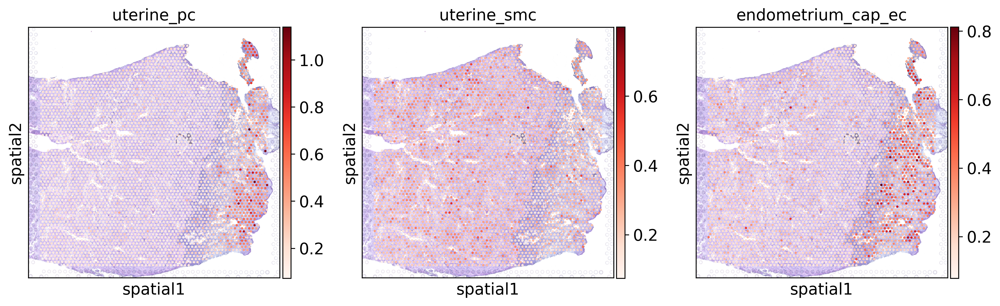

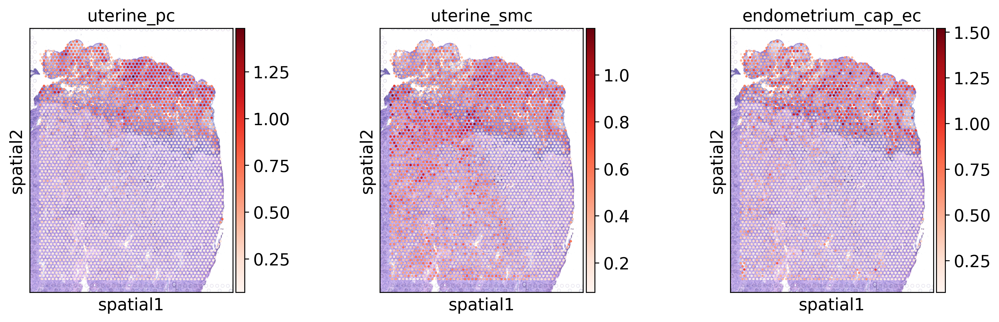

In [14]:
sc.set_figure_params(dpi=150)
celltypes = ['uterine_pc', 'uterine_smc', 'endometrium_cap_ec']

for samplename in uterus_vis.obs['sample'].unique():
    sc.pl.spatial(uterus_vis[uterus_vis.obs['sample'] == samplename],
                  library_id = samplename,
                  color=celltypes,
                  cmap="Reds",
                  save=f"uterus_{samplename}")

In [18]:
uterus_vis_sc = sc.read_h5ad("uterus_ref/ncells8_alpha200/sp.h5ad")
celltypes = uterus_vis_sc.uns['mod']['factor_names']
uterus_vis_sc.obs[uterus_vis_sc.uns['mod']['factor_names']] = uterus_vis_sc.obsm['q05_cell_abundance_w_sf']

In [19]:
for celltype in celltypes:
    if f'{celltype}_ori' in uterus_vis_sc.obs.columns:
        uterus_vis_sc.obs = uterus_vis_sc.obs.drop(f'{celltype}_ori', axis=1)
    uterus_vis_sc.obs = uterus_vis_sc.obs.rename({celltype: f'{celltype}_ori'}, axis=1)
    uterus_vis_sc.obs[f'{celltype}'] = uterus_vis_sc.obs[f'{celltype}_ori'].apply(lambda x:x if x >= 1.5 else 0)
# spots with at least two celltypes
uterus_vis_sc.obs['valid_celltypes_number'] = [(x>0).sum() for x in uterus_vis_sc.obs[celltypes].values]
nmf_uterus_vis_sc = uterus_vis_sc[uterus_vis_sc.obs['valid_celltypes_number'] >= 1].copy()

# # not care about CM and epithelial cells
# nmf_uterus_vis_sc.obsm['q05_cell_abundance_w_sf'] = nmf_uterus_vis_sc.obsm['q05_cell_abundance_w_sf'].drop("q05cell_abundance_w_sf_CM", axis=1)
# nmf_uterus_vis_sc.obsm['q05_cell_abundance_w_sf'] = nmf_uterus_vis_sc.obsm['q05_cell_abundance_w_sf'].drop("q05cell_abundance_w_sf_Epithelial cells", axis=1)
# nmf_uterus_vis_sc.uns['mod']['factor_names'] = [x.replace('q05cell_abundance_w_sf_', '') for x in nmf_heart_sc.obsm['q05_cell_abundance_w_sf'].columns]

In [20]:
uterus_res_dict, nmf_uterus_vis_sc = run_colocation(
    nmf_uterus_vis_sc,
    model_name='CoLocatedGroupsSklearnNMF',
    train_args={
      'n_fact': [5, 8, 10, 12, 16, 30],
      'sample_name_col': 'sample',
      'n_restarts': 3,
    },
    model_kwargs={'alpha': 0.01, 'init': 'random', "nmf_kwd_args": {"tol": 0.0000001}},
    export_args={'path': f'uterus_ref/CoLocatedComb/'}
)

### Analysis name: CoLocatedGroupsSklearnNMF_5combinations_1240locations_16factors
### Analysis name: CoLocatedGroupsSklearnNMF_8combinations_1240locations_16factors


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


### Analysis name: CoLocatedGroupsSklearnNMF_10combinations_1240locations_16factors


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


### Analysis name: CoLocatedGroupsSklearnNMF_12combinations_1240locations_16factors


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


### Analysis name: CoLocatedGroupsSklearnNMF_16combinations_1240locations_16factors


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


### Analysis name: CoLocatedGroupsSklearnNMF_30combinations_1240locations_16factors


/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/lustre/scratch126/cellgen/team205/sl37/conda_envs/cell2loc_env/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
